<a href="https://colab.research.google.com/github/AzisilhamK463/UAS_PCVK/blob/main/Tubes_PCVK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tugas Besar PCVK

In [14]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [15]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers, models
from tensorflow.keras.models import load_model
from keras.preprocessing.image import ImageDataGenerator
import numpy as np
import cv2 as cv
import imutils
import os
from google.colab.patches import cv2_imshow
from imutils.contours import sort_contours

In [16]:
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs = {}):
    if (logs.get('accuracy') > 0.99):
      print('\nAkurasi mencapai 99%')
      self.model.stop_training = True

callbacks = myCallback()

In [17]:
def load_data(folder_path):
    data = []
    labels = []
    label_dict = {}
    label_counter = 0

    for label in os.listdir(folder_path):
        label_dict[label_counter] = label
        label_path = os.path.join(folder_path, label)
        for image_file in os.listdir(label_path):
            image_path = os.path.join(label_path, image_file)

            try:
                # Coba membaca gambar
                image = cv.imread(image_path, cv.IMREAD_GRAYSCALE)

                if image is not None and not image.size == 0:
                    # Resize gambar ke dimensi yang diinginkan
                    image = cv.resize(image, (32, 32))
                    data.append(image)
                    labels.append(label_counter)
            except Exception as e:
                print(f"Error processing image {image_path}: {str(e)}")

        label_counter += 1

    return np.array(data), np.array(labels), label_dict


def train_ocr_model(folder_path, save_path = "final_model.keras"):
    # Memuat data dari folder huruf
    data, labels, label_dict = load_data(folder_path)

    # Membagi data menjadi train dan test set
    X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

    # Mengonversi label menjadi one-hot encoding
    y_train = to_categorical(y_train, num_classes=len(label_dict))
    y_test = to_categorical(y_test, num_classes=len(label_dict))

    # Membangun model CNN
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(32, 32, 1)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(128, activation='relu'))
    model.add(layers.Dense(len(label_dict), activation='softmax'))  # Jumlah kelas sesuai dengan jumlah huruf

    # Kompilasi model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    # Praproses data untuk format yang diterima oleh model
    X_train = X_train.reshape((X_train.shape[0], 32, 32, 1)).astype('float32') / 255
    X_test = X_test.reshape((X_test.shape[0], 32, 32, 1)).astype('float32') / 255

    # Augmentasi data menggunakan ImageDataGenerator
    datagen = ImageDataGenerator(rotation_range=10, zoom_range=0.1, width_shift_range=0.1, height_shift_range=0.1)
    datagen.fit(X_train)

    # Pelatihan model
    history = model.fit(datagen.flow(X_train, y_train, batch_size=32), epochs=30, validation_data=(X_test, y_test), callbacks = [callbacks])

    # Evaluasi model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Simpan model
    model.save(save_path)
    print(f'Model saved to {save_path}')

In [10]:
train_ocr_model("/content/gdrive/MyDrive/PCVK_UAS/dataset/training_dataset")

Epoch 1/30
35/35 [==============================] - 5s 28ms/step - loss: 3.3344 - accuracy: 0.0950 - val_loss: 3.2088 - val_accuracy: 0.1095
Epoch 2/30
35/35 [==============================] - 1s 14ms/step - loss: 2.9685 - accuracy: 0.2064 - val_loss: 2.5395 - val_accuracy: 0.4599
Epoch 3/30
35/35 [==============================] - 1s 14ms/step - loss: 2.2420 - accuracy: 0.4648 - val_loss: 1.7220 - val_accuracy: 0.5803
Epoch 4/30
35/35 [==============================] - 1s 14ms/step - loss: 1.5888 - accuracy: 0.6018 - val_loss: 1.2042 - val_accuracy: 0.7153
Epoch 5/30
35/35 [==============================] - 0s 13ms/step - loss: 1.2028 - accuracy: 0.6795 - val_loss: 0.8450 - val_accuracy: 0.7774
Epoch 6/30
35/35 [==============================] - 0s 14ms/step - loss: 0.9756 - accuracy: 0.7224 - val_loss: 0.7269 - val_accuracy: 0.8175
Epoch 7/30
35/35 [==============================] - 0s 14ms/step - loss: 0.8461 - accuracy: 0.7671 - val_loss: 0.6295 - val_accuracy: 0.8431
Epoch 8/30
35

In [11]:
# Load Model.

load_network = load_model('/content/final_model.keras')
load_network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 30, 30, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 15, 15, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 2304)              0         
                                                                 
 dense (Dense)               (None, 128)               2

In [18]:
def find_contours(img):
    # Fungsi find_contours dari OpenCV
    contours = cv.findContours(img, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    contours = imutils.grab_contours(contours)
    contours = sort_contours(contours, method='left-to-right')[0]
    return contours

# Fungsi preprocessing citra
def preprocess_img(img):
  gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
  blur = cv.GaussianBlur(gray, (3,3), 7)
  edges = cv.Canny(blur, 40, 150)
  dilation = cv.dilate(edges, np.ones((5,5)))
  erode = cv.erode(dilation, np.ones((1,1)))

  return erode

def predict_and_show(image_path, model):
    img_ktm = cv.imread(image_path)

    prep_ktm = preprocess_img(img_ktm)
    gray_ktm = cv.cvtColor(img_ktm, cv.COLOR_BGR2GRAY)

    # Menemukan kontur pada citra KTM
    conts_border = find_contours(prep_ktm)

    # Menampilkan citra KTM dengan kontur
    img_with_contour_ktm = img_ktm.copy()
    for c in conts_border:
        (x, y, w, h) = cv.boundingRect(c)
        cv.rectangle(img_with_contour_ktm, (x, y), (x + w, y + h), (255, 0, 0), 3)

    # Menampilkan citra KTM dengan opencv_imshow
    cv2_imshow(img_with_contour_ktm)

    # Mengambil karakter yang sudah di deteksi
    for c in conts_border:
        (x, y, w, h) = cv.boundingRect(c)
        char_img = gray_ktm[y:y+h, x:x+w]
        char_img_resized = cv.resize(char_img, (32, 32))
        char_img_resized = char_img_resized.reshape((1, 32, 32, 1)).astype('float32') / 255

        # Melakukan prediksi menggunakan model
        prediction = model.predict(char_img_resized)
        predicted_label = np.argmax(prediction)

        # Menampilkan hasil prediksi pada citra KTM
        cv.putText(img_with_contour_ktm, f'{predicted_label}', (x, y - 10),
                    cv.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Menampilkan citra KTM dengan opencv_imshow
    cv2_imshow(img_with_contour_ktm)

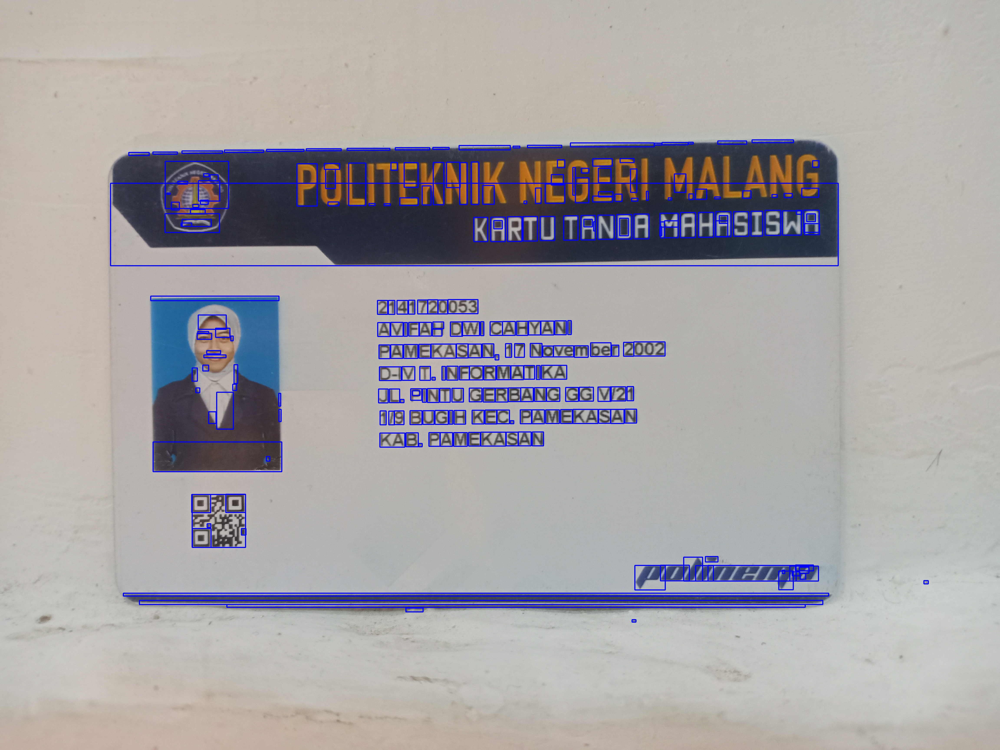

1/1 [==============================] - 0s 31ms/step


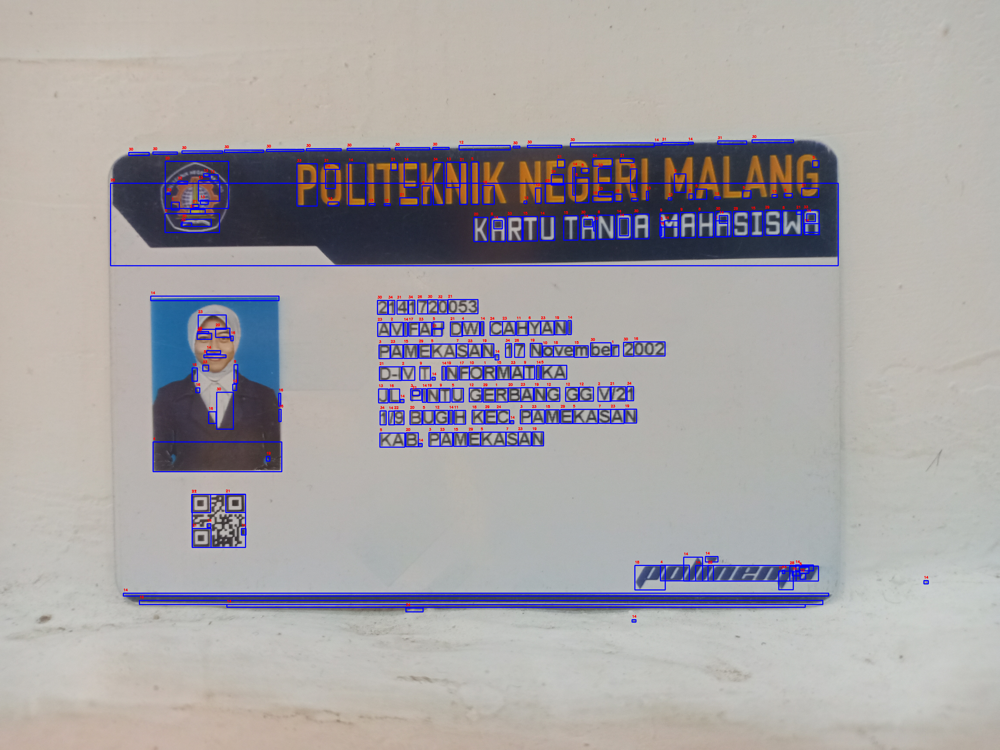

In [19]:
test_image_path = "/content/gdrive/MyDrive/PCVK_UAS/prediction_test/3E_2141720053_1 - Avifah Dwi Cahyani.jpg"
predict_and_show(test_image_path, load_network)